##### This script covers the main steps in the data exploration process using Python. 

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
import numpy as np

In [2]:
data = pd.read_csv('energydata.csv')

In [3]:
# Check for missing values
print(data.isnull().sum())

# Fill missing values or drop rows/columns with missing values
# data.fillna(data.mean(), inplace=True)  # For numerical columns
data.dropna(inplace=True)  # Remove rows with missing values

# Remove duplicates
data.drop_duplicates(inplace=True)


date           0
Appliances     0
lights         0
T1             0
RH_1           0
T2             0
RH_2           0
T3             0
RH_3           0
T4             0
RH_4           0
T5             0
RH_5           0
T6             0
RH_6           0
T7             0
RH_7           0
T8             0
RH_8           0
T9             0
RH_9           0
T_out          0
Press_mm_hg    0
RH_out         0
Windspeed      0
Visibility     0
Tdewpoint      0
rv1            0
rv2            0
dtype: int64


In [4]:
# Display basic statistics
print(data.describe())

# Display data types
print(data.dtypes)


         Appliances        lights            T1          RH_1            T2  \
count  19735.000000  19735.000000  19735.000000  19735.000000  19735.000000   
mean      97.694958      3.801875     21.686571     40.259739     20.341219   
std      102.524891      7.935988      1.606066      3.979299      2.192974   
min       10.000000      0.000000     16.790000     27.023333     16.100000   
25%       50.000000      0.000000     20.760000     37.333333     18.790000   
50%       60.000000      0.000000     21.600000     39.656667     20.000000   
75%      100.000000      0.000000     22.600000     43.066667     21.500000   
max     1080.000000     70.000000     26.260000     63.360000     29.856667   

               RH_2            T3          RH_3            T4          RH_4  \
count  19735.000000  19735.000000  19735.000000  19735.000000  19735.000000   
mean      40.420420     22.267611     39.242500     20.855335     39.026904   
std        4.069813      2.006111      3.254576    

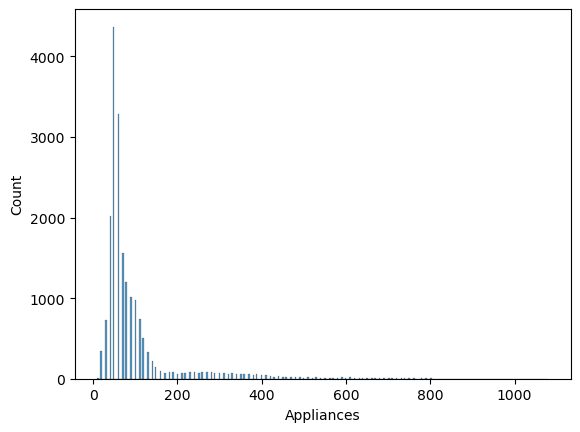

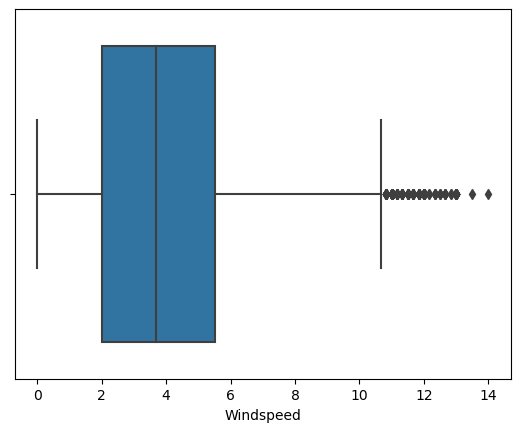

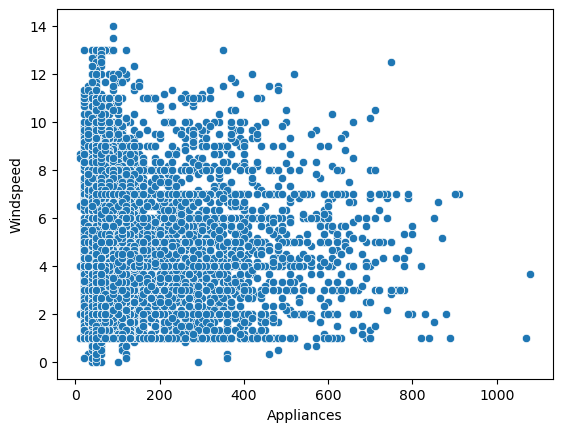

In [5]:

# Histogram of a specific column
sns.histplot(data['Appliances'])
plt.show()

# Box plot for another column
sns.boxplot(x=data['Windspeed'])
plt.show()

# Scatter plot to explore relationship between two numerical variables
sns.scatterplot(x='Appliances', y='Windspeed', data=data)
plt.show()


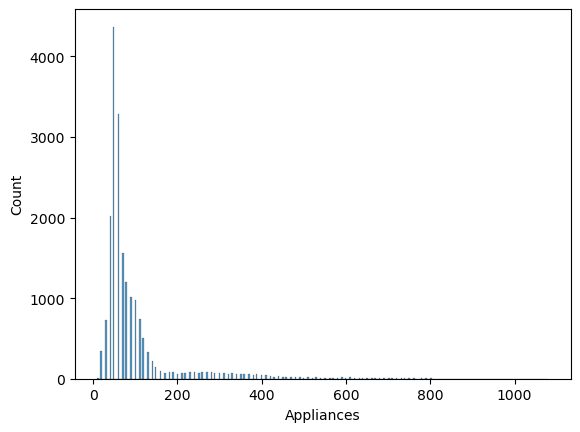

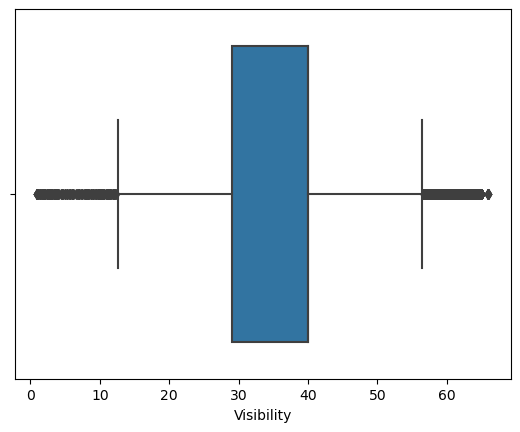

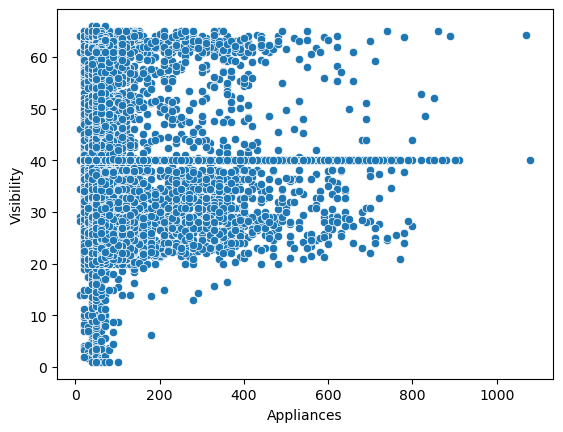

In [6]:
# Histogram of a specific column
sns.histplot(data['Appliances'])
plt.show()

# Box plot for another column
sns.boxplot(x=data['Visibility'])
plt.show()

# Scatter plot to explore relationship between two numerical variables
sns.scatterplot(x='Appliances', y='Visibility', data=data)
plt.show()

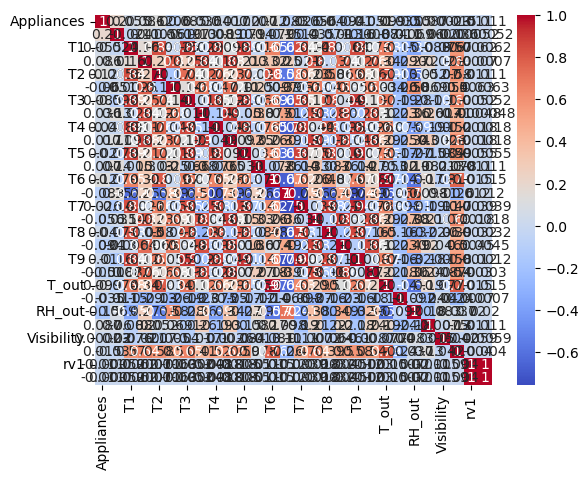

In [16]:
# Correlation matrix
correlation_matrix = data.corr()
# print(correlation_matrix)

# Heatmap of the correlation matrix
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.show()


In [17]:
# More detailed correlation analysis
strong_correlations = correlation_matrix[correlation_matrix.abs() > 0.8]
print(strong_correlations)


             Appliances  lights        T1      RH_1        T2  RH_2        T3  \
Appliances          1.0     NaN       NaN       NaN       NaN   NaN       NaN   
lights              NaN     1.0       NaN       NaN       NaN   NaN       NaN   
T1                  NaN     NaN  1.000000       NaN  0.836834   NaN  0.892402   
RH_1                NaN     NaN       NaN  1.000000       NaN   NaN       NaN   
T2                  NaN     NaN  0.836834       NaN  1.000000   NaN       NaN   
RH_2                NaN     NaN       NaN       NaN       NaN   1.0       NaN   
T3                  NaN     NaN  0.892402       NaN       NaN   NaN  1.000000   
RH_3                NaN     NaN       NaN  0.844677       NaN   NaN       NaN   
T4                  NaN     NaN  0.877001       NaN       NaN   NaN  0.852778   
RH_4                NaN     NaN       NaN  0.880359       NaN   NaN       NaN   
T5                  NaN     NaN  0.885247       NaN       NaN   NaN  0.888169   
RH_5                NaN     

In [18]:
from sklearn.decomposition import PCA

# PCA for dimensionality reduction
pca = PCA(n_components=5)
reduced_data = pca.fit_transform(data.select_dtypes(include=[np.number]))
print(reduced_data.shape)


(19735, 5)


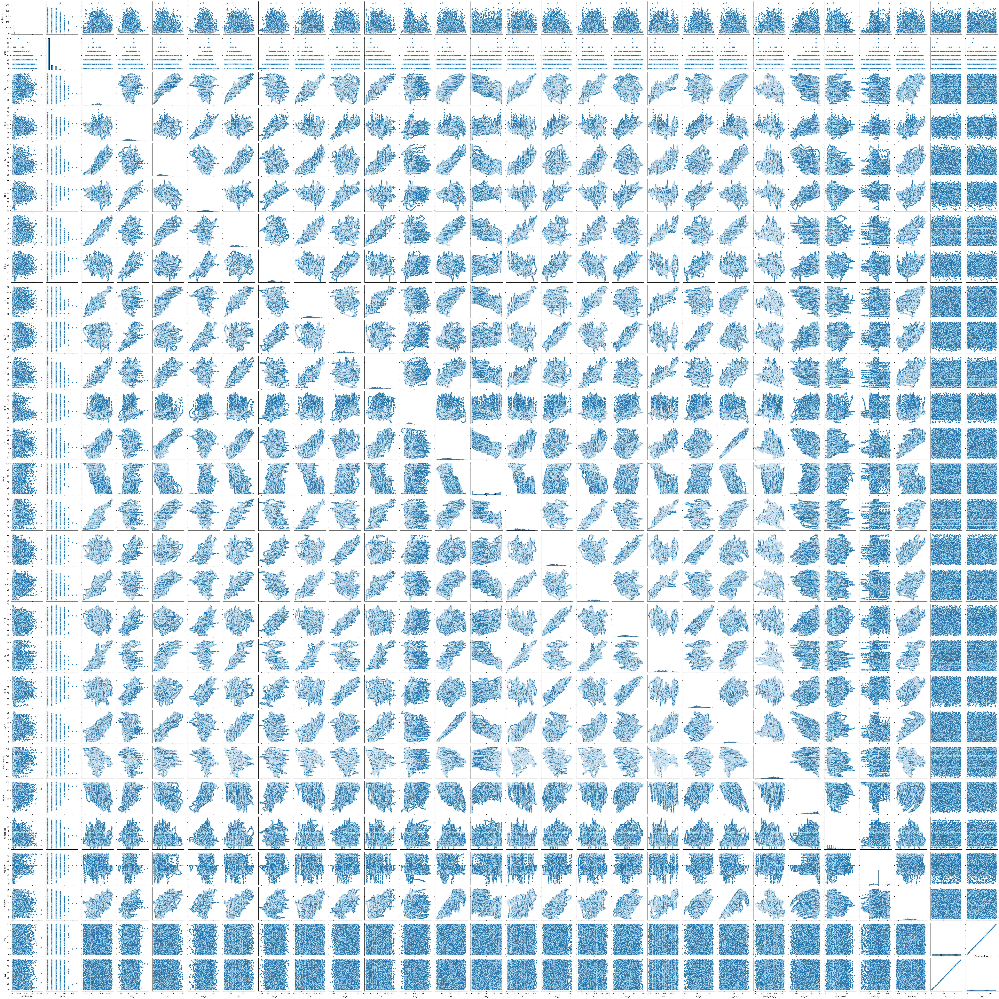

In [19]:
#Scatter plot
sns.pairplot(data, kind='scatter')
plt.title('Scatter Plot')
plt.show()